**Image Similarity Search with Pytorch Metric Learning Project**

Code Reference: https://keras.io/examples/vision/metric_learning/

Name: Anthony Kevin Oktavius

In [1]:
! pip install datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.6/519.6 kB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 14.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 12.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 15.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 14.9 MB/s eta 0:00:00


Library Import

In [2]:
import numpy as np
import zipfile
import gc
import cv2
import math
import warnings
import random
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import albumentations as A
import torchvision
import torchvision.transforms.functional as TF
import torchvision.transforms as transforms
import torch.utils.data as data_utils
import torch
import torchvision
import torchvision.transforms as transforms
import torch.optim as optim
import torch.nn as nn
# import torchmetrics
import torch.nn.functional as F
import PIL
import torch.utils.data as data_utils
import json

# import pytorch_lightning as pl
import imutils
import zipfile

from torch.utils.data import Dataset
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from tensorflow.python.client import device_lib
from zipfile import ZipFile
from IPython import display
from torchvision import models, transforms
from google.colab.patches import cv2_imshow
from sklearn.metrics import confusion_matrix, roc_curve
from sklearn.preprocessing import LabelEncoder
from torchvision.models.feature_extraction import create_feature_extractor
from datasets import load_dataset
from PIL import Image
from collections import defaultdict
from google.colab import drive

In [20]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
print("Device Specifications:")
print(device_lib.list_local_devices())

Device Specifications:
[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 2673753536360591942
xla_global_id: -1
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 13839958016
locality {
  bus_id: 1
  links {
  }
}
incarnation: 12707708416891870869
physical_device_desc: "device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5"
xla_global_id: 416903419
]


In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

Download ImageNet mini Dataset

In [7]:
! cp ./kaggle.json ~/.kaggle/
! kaggle datasets download -d ifigotin/imagenetmini-1000
! unzip -qq ./imagenetmini-1000.zip -d ./Dataset

100% 3.92G/3.92G [00:56<00:00, 78.6MB/s]
100% 3.92G/3.92G [00:56<00:00, 75.0MB/s]


Download dataset classes.

In [8]:
! wget https://github.com/anishathalye/imagenet-simple-labels/raw/master/imagenet-simple-labels.json

--2023-09-10 16:01:24--  https://github.com/anishathalye/imagenet-simple-labels/raw/master/imagenet-simple-labels.json
Resolving github.com (github.com)... 140.82.112.4
Connecting to github.com (github.com)|140.82.112.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/anishathalye/imagenet-simple-labels/master/imagenet-simple-labels.json [following]
--2023-09-10 16:01:24--  https://raw.githubusercontent.com/anishathalye/imagenet-simple-labels/master/imagenet-simple-labels.json
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 14193 (14K) [text/plain]
Saving to: ‘imagenet-simple-labels.json’

imagenet-simple-lab 100%[===================>]  13.86K  --.-KB/s    in 0.04s   

2023-09-10 16:01:24 (316 K

Or, use the labels from google drive.

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


Store the classes from the text into the array of the variable.

In [9]:
class_file = open('imagenet-simple-labels.json')
class_names = json.load(class_file)

class_file.close()
print(class_names[:10])
print(len(class_names))

['tench', 'goldfish', 'great white shark', 'tiger shark', 'hammerhead shark', 'electric ray', 'stingray', 'cock', 'hen', 'ostrich']
1000


Retrieve ImageNet database dataset.

In [10]:
imagenet_train_image_folders = torchvision.datasets.ImageFolder(
    "Dataset/imagenet-mini/train",
)

imagenet_val_image_folders = torchvision.datasets.ImageFolder(
    "Dataset/imagenet-mini/val",
)

imagenet_train_image_folders.classes = class_names
imagenet_val_image_folders.classes = class_names

print(imagenet_train_image_folders.classes[:10])
print(imagenet_val_image_folders.classes[:10])

print(len(imagenet_train_image_folders.classes))
print(len(imagenet_val_image_folders.classes))

print(len(imagenet_train_image_folders))
print(len(imagenet_val_image_folders))

['tench', 'goldfish', 'great white shark', 'tiger shark', 'hammerhead shark', 'electric ray', 'stingray', 'cock', 'hen', 'ostrich']
['tench', 'goldfish', 'great white shark', 'tiger shark', 'hammerhead shark', 'electric ray', 'stingray', 'cock', 'hen', 'ostrich']
1000
1000
34745
3923


In [11]:
train_transform = transforms.Compose([
    transforms.CenterCrop((320, 320)),
    transforms.Resize((224, 224)), # Mitigate if there's a "RAM is not enough" error.
    transforms.RandomRotation(degrees = 5),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.ToTensor(),
    # transforms.Normalize(
    #     mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225],
    # ),
])

val_transform = transforms.Compose([
    transforms.CenterCrop((320, 320)),
    transforms.Resize((224, 224)), # Mitigate if there's a "RAM is not enough" error.
    transforms.ToTensor(),
    # transforms.Normalize(
    #     mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225],
    # ),
])

Recall, from the previous step, we already map all of the class indexes with train data.

Which means, we just instantly make (anchor, positive) pairs, so we'll just make a batch that consists of anchor, positive pairs across the classes.

In [12]:
class ImageNetMiniImageSimilarityDataset(Dataset):
  def __init__(self, image_folder, image_transform = None):
    super(ImageNetMiniImageSimilarityDataset, self).__init__()
    self.image_folder = image_folder
    self.image_transform = image_transform

  def __getitem__(self, item_index):
    image, label = self.image_folder[item_index]

    if self.image_transform is not None:
      image = self.image_transform(image)

    return (image, label)

  def __len__(self):
    return len(self.image_folder)

imagenet_train_mini_dataset = ImageNetMiniImageSimilarityDataset(
  image_folder = imagenet_train_image_folders,
  image_transform = train_transform,
)

imagenet_val_mini_dataset = ImageNetMiniImageSimilarityDataset(
  image_folder = imagenet_val_image_folders,
  image_transform = val_transform,
)

# Test the output from the dataset class.
print(imagenet_train_mini_dataset[1][0].shape)
print(imagenet_val_mini_dataset[1][0].shape)

torch.Size([3, 224, 224])
torch.Size([3, 224, 224])


Store image indexes, so we can make a random anchor positive points in the next code.

In [13]:
classes_to_index_train_dict = defaultdict(list)
classes_to_index_val_dict = defaultdict(list)

for train_image_index, (image, label_index) in enumerate(imagenet_train_mini_dataset):
  classes_to_index_train_dict[label_index].append(train_image_index)

for val_image_index, (image, label_index) in enumerate(imagenet_val_mini_dataset):
  classes_to_index_val_dict[label_index].append(val_image_index)

print(classes_to_index_train_dict[0])
print(classes_to_index_val_dict[0])

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33]
[0, 1, 2]


Make Anchor Positive Pairs Dataset from the given imagenet similarity dataset given.

In [14]:
class AnchorPositivePairsDataset(Dataset):
  def __init__(self, datasets, classes_to_index_dict, number_of_classes, BATCH_SIZE):
    super(AnchorPositivePairsDataset, self).__init__()
    self.datasets = datasets
    self.datasets_length = len(datasets)
    self.classes_to_index_dict = classes_to_index_dict
    self.number_of_classes = number_of_classes
    self.anchor_positive_pair_container_size = (2, 3, 224, 224)
    self.BATCH_SIZE = BATCH_SIZE

  def __generate_anchor_positive_pair__(self, class_index):
    while True:
      number_of_images_in_a_specific_class = len(self.classes_to_index_dict[class_index]) - 1
      # Get the index of the positive and anchor image.
      random_anchor_image_index = random.randint(0, number_of_images_in_a_specific_class)
      random_positive_image_index = random.randint(0, number_of_images_in_a_specific_class)

      # However, if the positive image and anchor image have the same index,
      # Offset the anchor image index by 1, by either addition or subtraction.
      if random_anchor_image_index == random_positive_image_index:
        if random_anchor_image_index == number_of_images_in_a_specific_class:
          random_anchor_image_index -= 1
        else:
          random_anchor_image_index += 1

      # Get the image number from the given class index and image index.
      random_anchor_image_number = self.classes_to_index_dict[class_index][random_anchor_image_index]
      random_positive_image_number = self.classes_to_index_dict[class_index][random_positive_image_index]

      # Store image and labels in each of the variables given.
      anchor_image = self.datasets[random_anchor_image_number][0]
      anchor_class = self.datasets[random_anchor_image_number][1]
      positive_image = self.datasets[random_positive_image_number][0]
      positive_class = self.datasets[random_positive_image_number][1]

      # Finally, we create a container to store positive and anchor image.
      anchor_positive_image_container = torch.empty(size = self.anchor_positive_pair_container_size)
      anchor_positive_image_container[0] = anchor_image
      anchor_positive_image_container[1] = positive_image

      return anchor_positive_image_container
      # return (positive_pair_image, positive_class)

  def __getitem__(self, class_index):
    image_matrix = torch.empty(size = (self.number_of_classes, *self.anchor_positive_pair_container_size))
    for class_index in range(self.number_of_classes):
      image_matrix[class_index] = self.__generate_anchor_positive_pair__(
        class_index,
      )

    return image_matrix

  def __len__(self):
    return self.BATCH_SIZE

BATCH_SIZE = 1
no_classes = 20

VAL_BATCH_SIZE = 20

anchor_positive_train_datasets = AnchorPositivePairsDataset(
  imagenet_train_mini_dataset,
  classes_to_index_train_dict,
  no_classes,
  BATCH_SIZE,
)

anchor_positive_val_datasets = AnchorPositivePairsDataset(
  imagenet_val_mini_dataset,
  classes_to_index_val_dict,
  no_classes,
  VAL_BATCH_SIZE,
)

print(anchor_positive_train_datasets[0].shape)
print(anchor_positive_val_datasets[0].shape)

torch.Size([20, 2, 3, 224, 224])
torch.Size([20, 2, 3, 224, 224])


Make Train Loader and Test Loader.

In [15]:
# Set the batch size as how many images in the same class we'd like to fit to
# the network.
# Example: If we specify the number of batch_size to be 2:
# Class 0 will have 2 image pairs.
# Class 1 will also have 2 image pairs.

# Example 2: If we specify the number of batch_size to be 5:
# Class 0 will have 5 image pairs.
# Class 1 will also have 5 image pairs.


imagenet_train_loader = torch.utils.data.DataLoader(
    anchor_positive_train_datasets,
    batch_size = BATCH_SIZE,
    shuffle = False,
)

imagenet_val_loader = torch.utils.data.DataLoader(
    anchor_positive_val_datasets,
    batch_size = VAL_BATCH_SIZE,
    shuffle = False,
)

## Data Visualization

Make Pytorch Grid using torch.utils.make_grid().

<ipython-input-29-e201cef63213>:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize = (10, 10))


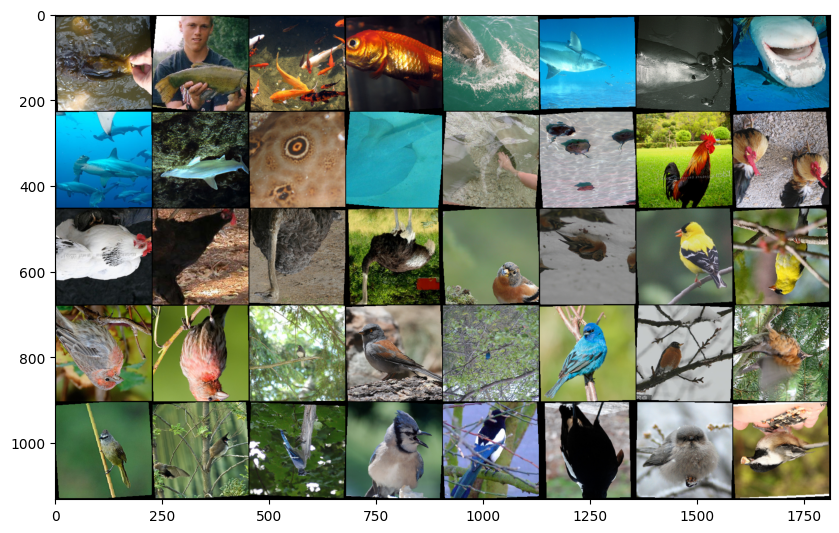

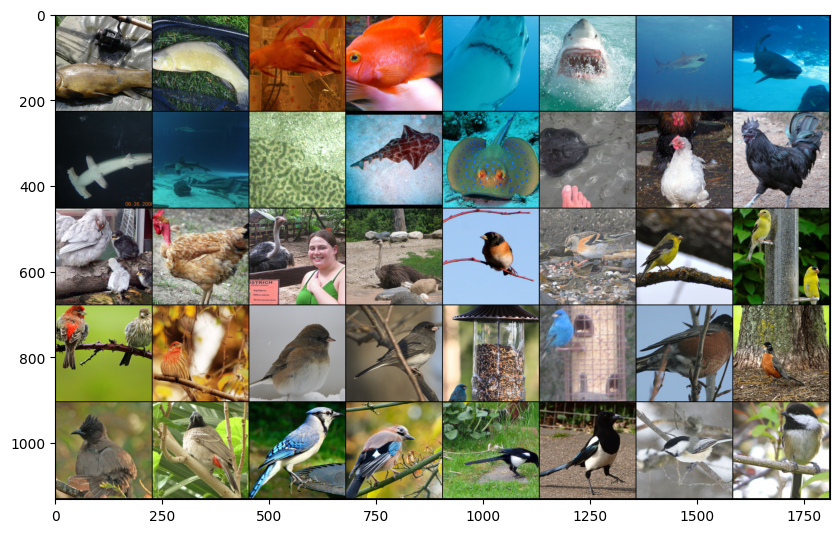

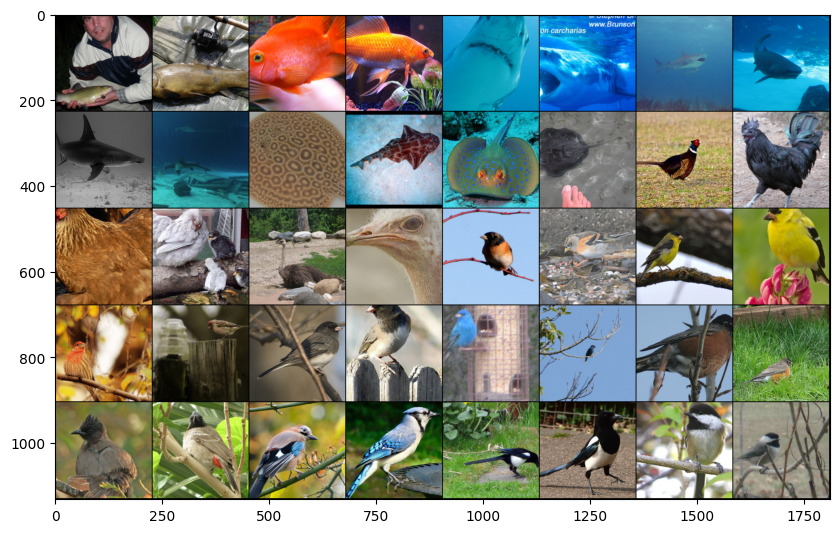

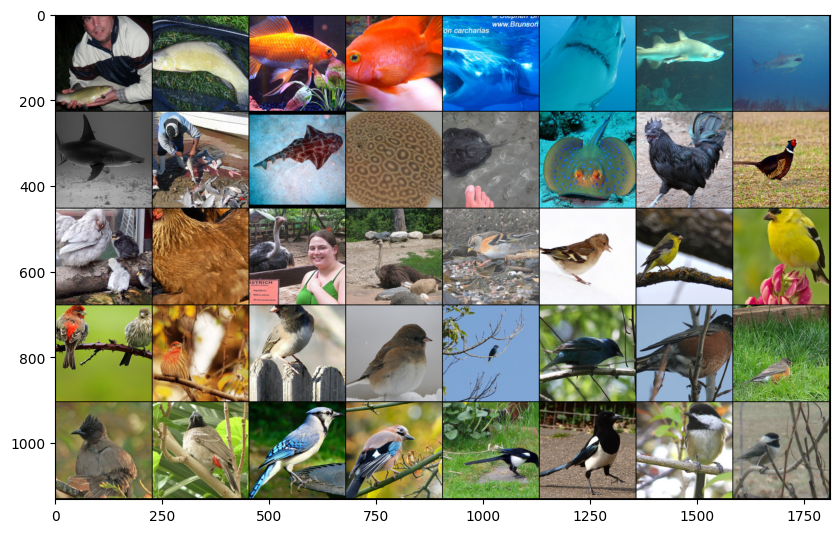

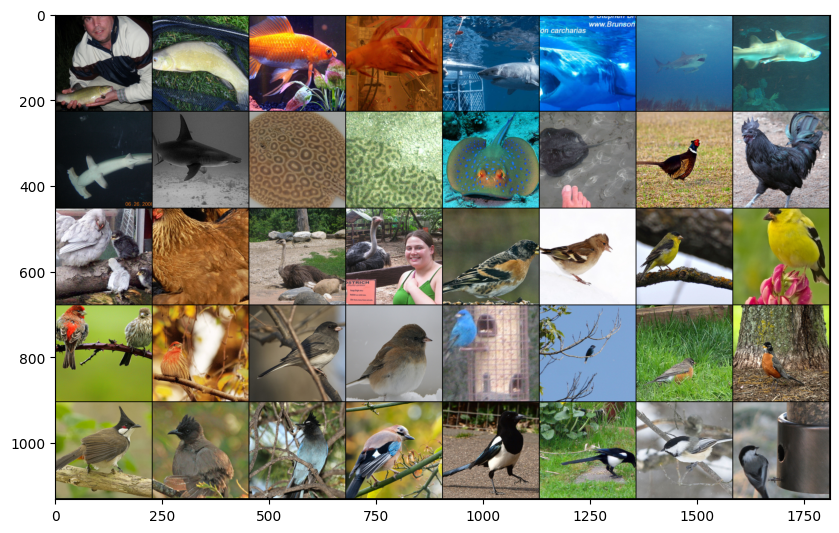

...

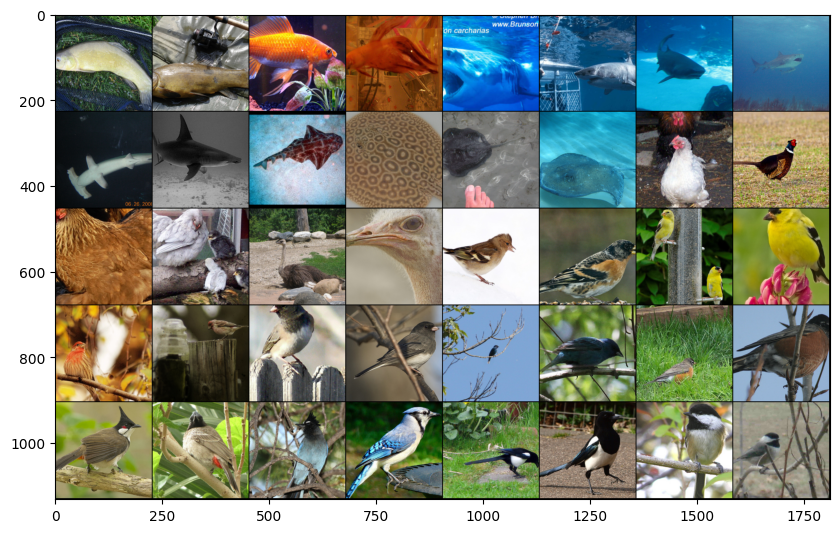

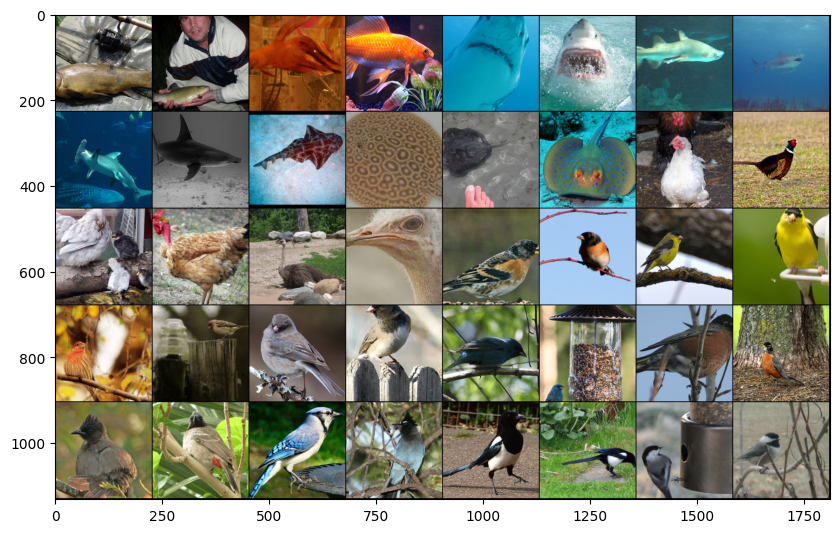

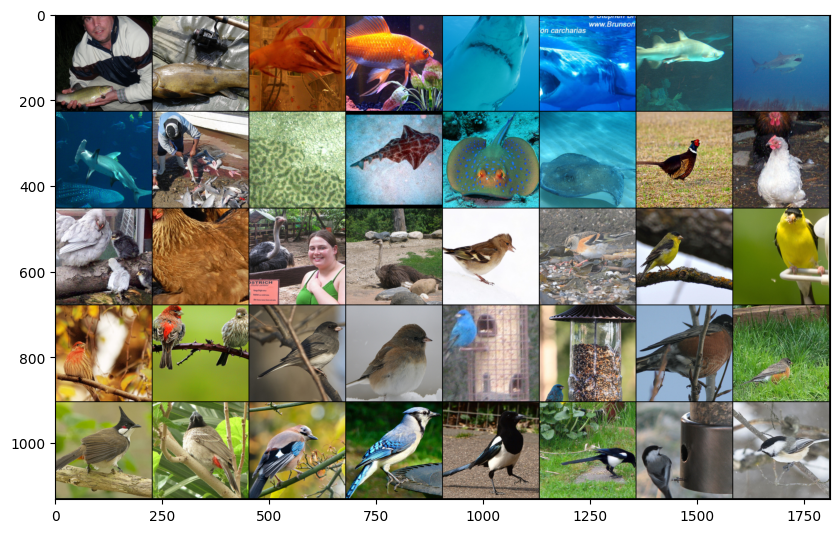

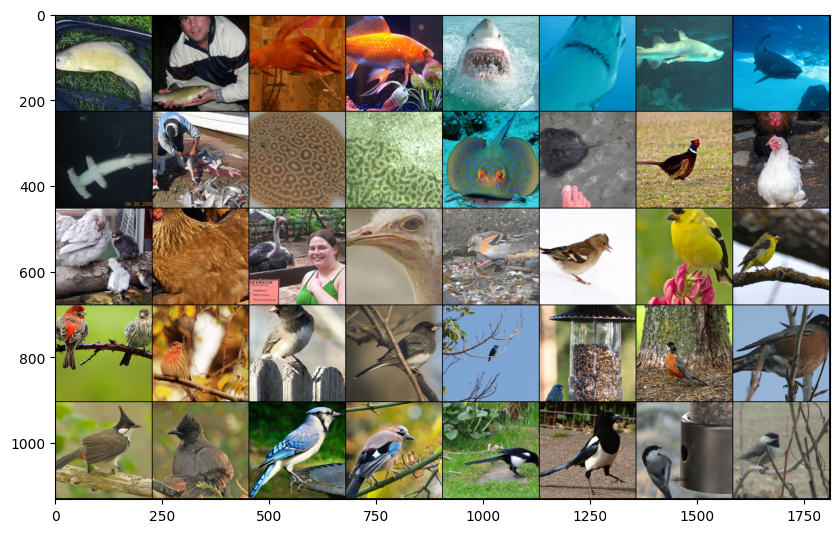

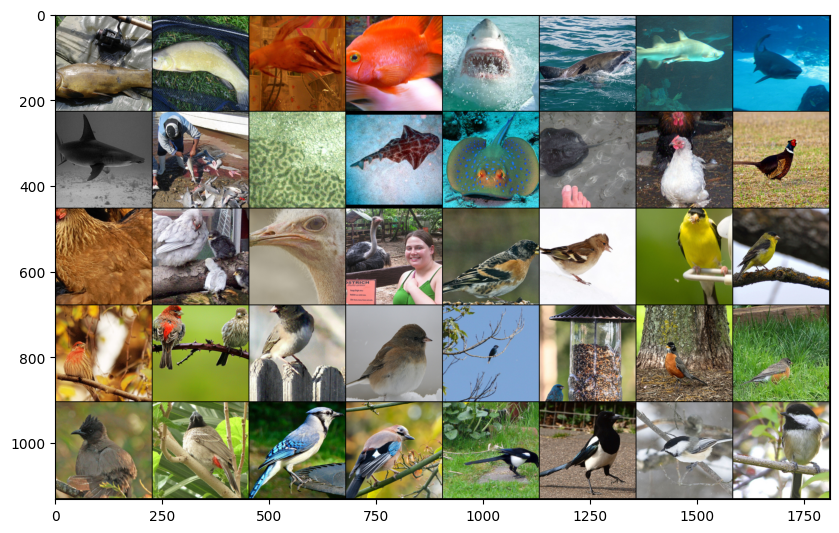

In [29]:
def visualize_pytorch_grid(images_in_batch):
  # print("===============")
  plt.figure(figsize = (10, 10))
  grid_images_in_batch = torchvision.utils.make_grid(images_in_batch)
  plt_compatible_grid_images_in_batch = np.transpose(grid_images_in_batch.numpy(), (1, 2, 0))
  plt.imshow(plt_compatible_grid_images_in_batch)

def visualize_dataloader(data_loader, title, max_classes):
  for output_images_per_batch in data_loader:
    for output_image_per_class in output_images_per_batch:
      merged_output_image_per_class = output_image_per_class.reshape(
        BATCH_SIZE * max_classes * 2, 3, 224, 224,
      )
      visualize_pytorch_grid(merged_output_image_per_class)
    break

visualize_dataloader(imagenet_train_loader, "Train Transformed Image", no_classes)
visualize_dataloader(imagenet_val_loader, "Validation Transformed Image", no_classes)

## Data Modelling

In this case, we're comparing performance between Contrastive Loss. Contrastive Loss looks like this.

![Contrastive Loss](https://miro.medium.com/v2/resize:fit:926/1*61b62NNTAqmYSORV-QRo9Q.png)

However, we don't use single image only, but with multiple images of the same class. Which means, a single instance will contain more than one images, like we did on the previous code cell.


We'll make a contrastive loss metric using Cosine Similarity.

In [30]:
def get_cosine_similarity(dense_vector_1, dense_vector_2):
  cosine_similarities_value = torch.einsum(
      "ae, pe -> ap",
      # "bea, bep -> bap",
      dense_vector_1,
      dense_vector_2,
  )
  return cosine_similarities_value

class SoftmaxTemperatureLoss(nn.Module):
  def __init__(self, loss_function, number_of_labels, temperature = 0.2):
    super(SoftmaxTemperatureLoss, self).__init__()
    self.temperature = temperature
    self.loss_function = loss_function
    self.number_of_labels = number_of_labels

  def forward(self, dense_vector_1, dense_vector_2):
    # print(dense_vector_1.shape)
    # print(dense_vector_2.shape)

    # Calculate cosine similarity value to which will act as a prediction.

    cosine_similarities_value = get_cosine_similarity(
        dense_vector_1, dense_vector_2
    )

    # cosine_similarities_value = F.cosine_similarity(
    #     dense_vector_1,
    #     dense_vector_2,
    #     dim = 0
    # )
    # cosine_similarities_value = cosine_similarities_value[:, None]
    # Perform Softmax Temperature.
    cosine_similarities_value /= self.temperature

    labels = torch.range(0, self.number_of_labels - 1, dtype=int).to(device)

    # print(cosine_similarities_value.shape)
    # print(labels.shape)
    # print(cosine_similarities_value.dtype)
    # print(labels.dtype)
    # print(labels)
    # print(cosine_similarities_value)

    loss_value = self.loss_function(cosine_similarities_value, labels)
    return loss_value

In [31]:
class GlobalAveragePooling2D(nn.Module):
  def __init__(self):
    super(GlobalAveragePooling2D, self).__init__()

  def forward(self, feature_maps):
    adaptive_average_pool_2d = nn.AdaptiveAvgPool2d((1,1))
    return adaptive_average_pool_2d(feature_maps)

In [32]:
class L2Normalization(nn.Module):
  def __init__(self, dim = 1, eps = 1e-12):
    super(L2Normalization, self).__init__()
    self.dim = dim
    self.eps = eps

  def forward(self, x):
    return F.normalize(
        x,
        p = 2,
        dim = self.dim,
        eps = self.eps
    )

In [38]:
class ImageSimilarityModel(nn.Module):
  def __init__(self, number_of_classes):
    super(ImageSimilarityModel, self).__init__()
    # Final output image: 224 x 224
    self.conv_1 = nn.Sequential(
        nn.Conv2d(in_channels = 3, out_channels = 64, kernel_size = (3, 3), padding = 1, stride = 2),
        # nn.MaxPool2d(2),
        nn.ReLU(),
    )
    # Final output image: 112 x 112
    self.conv_2 = nn.Sequential(
        nn.Conv2d(in_channels = 64, out_channels = 128, kernel_size = (3, 3), padding = 1, stride = 2),
        # nn.MaxPool2d(2),
        nn.ReLU(),
    )
    # # Final output image: 56 x 56.
    # self.conv_3 = nn.Sequential(
    #     nn.Conv2d(in_channels = 128, out_channels = 256, kernel_size = (2, 2), padding = 1),
    #     nn.MaxPool2d(2),
    #     nn.ReLU(),
    # )
    # Final output image: 28 x 28
    self.global_average_pooling_2d = GlobalAveragePooling2D()
    # self.flatten = nn.Flatten()
    self.dense_1 = nn.Linear(128, 128)
    # self.l2_normalization = L2Normalization(dim = -1)

  def forward_once(self, x):
    x = self.conv_1(x)
    x = self.conv_2(x)
    # x = self.conv_3(x)
    # x = self.conv_4(x)
    # print(f"0: {x.shape}")
    x = self.global_average_pooling_2d(x)
    x = x.view(x.shape[0], -1)
    # print(f"1: {x.shape}")
    x = self.dense_1(x)
    # x = self.dense_2(x)
    # x = self.dense_3(x)
    # print(f"2: {x.shape}")
    # x = self.l2_normalization(x)
    return x

  def forward(self, images_1, images_2):
    images_1 = self.forward_once(images_1)
    images_2 = self.forward_once(images_2)
    return images_1, images_2

image_similarity_model = ImageSimilarityModel(
    no_classes
  ).to(device)
image_similarity_model

ImageSimilarityModel(
  (conv_1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): ReLU()
  )
  (conv_2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): ReLU()
  )
  (global_average_pooling_2d): GlobalAveragePooling2D()
  (dense_1): Linear(in_features=128, out_features=128, bias=True)
)

Let's train the model to learn the similarity patterns between each images!

This code below works if you only have 1 batch per class.

In [ ]:
image_similarity_model = ImageSimilarityModel(
    no_classes
  ).to(device)

softmax_temperature_loss = SoftmaxTemperatureLoss(
    loss_function = nn.CrossEntropyLoss(),
    number_of_labels = no_classes,
)
optimizer = optim.Adam(image_similarity_model.parameters(), lr = 0.001)

N_EPOCHS = 10000

for current_epoch in range(N_EPOCHS):
  # total_loss = 0

  for train_iteration, images in enumerate(imagenet_train_loader):
    images = images.to(device)

    anchor_images = images[:, :, 0, :, :, :].view(BATCH_SIZE * no_classes, 3, 224, 224)
    positive_images = images[:, :, 1, :, :, :].view(BATCH_SIZE * no_classes, 3, 224, 224)

    # Model Training.
    total_loss_all_classes_given = 0
    # for anchor_image_per_class, positive_image_per_class in zip(anchor_images, positive_images,):
      # print(anchor_images.shape)
      # Update loss for each classes given.
    anchor_output, positive_output = image_similarity_model(
      anchor_images,
      positive_images
    )

    # print(anchor_output.shape)
    # print(positive_output.shape)

    # anchor_output = anchor_output.view(no_classes, 56 * 8)
    # positive_output = positive_output.view(no_classes, 56 * 8)
    # print(anchor_output.shape)
    # print(positive_output.shape)

    loss = softmax_temperature_loss(
        anchor_output,
        positive_output,
    )

    # total_loss_all_classes_given += loss
    loss.backward()

    if train_iteration % 10 == 0:
        print(f"Epochs: {current_epoch} / {N_EPOCHS}, Iteration: {train_iteration}, loss: {loss.item()}")

    optimizer.step()
    optimizer.zero_grad()

<ipython-input-45-6c274b4d772f>:36: UserWarning: torch.range is deprecated and will be removed in a future release because its behavior is inconsistent with Python's range builtin. Instead, use torch.arange, which produces values in [start, end).
  labels = torch.range(0, self.number_of_labels - 1, dtype=int).to(device)


Streaming output truncated to the last 5000 lines.
Epochs: 2096 / 10000, Iteration: 0, loss: 2.7495319843292236
Epochs: 2097 / 10000, Iteration: 0, loss: 2.7117791175842285
Epochs: 2098 / 10000, Iteration: 0, loss: 2.863477945327759
Epochs: 2099 / 10000, Iteration: 0, loss: 2.689568042755127
Epochs: 2100 / 10000, Iteration: 0, loss: 2.7764663696289062
Epochs: 2101 / 10000, Iteration: 0, loss: 2.738482713699341
Epochs: 2102 / 10000, Iteration: 0, loss: 2.926565647125244
Epochs: 2103 / 10000, Iteration: 0, loss: 2.8244690895080566
Epochs: 2104 / 10000, Iteration: 0, loss: 2.7382993698120117
Epochs: 2105 / 10000, Iteration: 0, loss: 2.786405086517334
Epochs: 2106 / 10000, Iteration: 0, loss: 2.732764720916748
Epochs: 2107 / 10000, Iteration: 0, loss: 2.6102330684661865
Epochs: 2108 / 10000, Iteration: 0, loss: 2.810394287109375
Epochs: 2109 / 10000, Iteration: 0, loss: 2.613225221633911
Epochs: 2110 / 10000, Iteration: 0, loss: 2.7943553924560547
Epochs: 2111 / 10000, Iteration: 0, loss: 

KeyboardInterrupt: ignored

If we have the model, let's just use the model instantly.

In [34]:
save_path = f"drive/MyDrive/Models/image_similarity_model_{device}"

In [35]:
image_similarity_model = torch.load(save_path)
image_similarity_model

ImageSimilarityModel(
  (conv_1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): ReLU()
  )
  (conv_2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): ReLU()
  )
  (global_average_pooling_2d): GlobalAveragePooling2D()
  (dense_1): Linear(in_features=128, out_features=128, bias=True)
)

Save the model for future use.

In [ ]:
torch.save(image_similarity_model, save_path)

## Model Testing

Now, we perform model testing by using nearest neighbors (cosine similarity), to perform image similarity.

In [40]:
NUMBER_OF_NEAREST_NEIGHBORS = 5

def get_nearest_neighbours_from_gram_matrix(gram_matrix, number_of_nearest_neighbors):
  return np.argsort(gram_matrix.T)[:, -(number_of_nearest_neighbors + 1) : ]

def get_sample_images_in_one_batch(image_data_loader, batch_size, no_classes, device):
  iter_val_images = iter(image_data_loader)
  images_in_one_batches = next(iter_val_images).to(device)
  dataset = images_in_one_batches[:, :, 0, :, :, :]
  dataset = dataset.view(batch_size * no_classes, 3, 224, 224)
  return dataset

with torch.no_grad():

  val_dataset = get_sample_images_in_one_batch(
      image_data_loader = imagenet_val_loader,
      device = device,
      batch_size = VAL_BATCH_SIZE,
      no_classes = no_classes
  )

  print(f"Dataset size: {val_dataset.shape}")

  # for val_index, val_datum in enumerate(val_dataset):
  val_embedding = image_similarity_model.forward_once(val_dataset)

  gram_matrix = get_cosine_similarity(
      val_embedding, val_embedding
  ).cpu()

  nearest_neighbours = get_nearest_neighbours_from_gram_matrix(
    gram_matrix,
    NUMBER_OF_NEAREST_NEIGHBORS
  )

  print(f"Gram matrix size: {gram_matrix.shape}")

  print(f"Min image index value for nearest neighbors: {nearest_neighbours.max()}")
  print(f"Max image index value for nearest neighbors: {nearest_neighbours.min()}")
  print(f"Nearest Neighbours shape: {nearest_neighbours.shape}")


Dataset size: torch.Size([400, 3, 224, 224])
Gram matrix size: torch.Size([400, 400])
Min image index value for nearest neighbors: 262
Max image index value for nearest neighbors: 2
Nearest Neighbours shape: torch.Size([400, 6])


See the sample output of nearest neighbours.

In [41]:
nearest_neighbours[0]

tensor([142, 122, 262, 250,  90,  30])

Get the first 5 most similar images from the given gram matrix.

In [ ]:
num_college_examples = 10
similar_images_in_collage = np.empty((
    num_college_examples,
    (NUMBER_OF_NEAREST_NEIGHBORS + 1),
    3,
    128,
    128,
    ),
    dtype = np.float32,
)

with torch.no_grad():
  val_datasets = get_sample_images_in_one_batch(
      image_data_loader = imagenet_val_loader,
      device = device,
      batch_size = VAL_BATCH_SIZE,
      no_classes = no_classes
  ).cpu()
  for sample_image_index in range(num_college_examples):
    print(sample_image_index)
    print(val_datasets[sample_image_index].shape)
    similar_images_in_collage[sample_image_index, 0] = val_datasets[sample_image_index]
    anchor_nearest_neighbors = reversed(nearest_neighbours[sample_image_index][:-1])
    for similar_image_index_index, similar_image_index in enumerate(anchor_nearest_neighbors):
      print(similar_image_index)
      print(val_datasets[similar_image_index].shape)
      similar_images_in_collage[sample_image_index, similar_image_index_index+1] = val_datasets[similar_image_index]

similar_images_in_collage.shape

0
torch.Size([3, 128, 128])
tensor([171, 111, 271,  51, 351,  31, 341, 181, 201, 361, 241,  61, 281,  21,
         81, 251, 211,  11, 391, 131, 356,  36, 296, 376, 256, 336,  76,  96,
        276,  16,  56, 316, 176, 156, 378,  38,  58, 198, 258, 138, 238, 158,
         18, 272, 312, 392, 132, 152, 112, 288, 388, 248, 108, 208, 148,  68,
        228, 323, 123, 263, 163, 283, 101,  41, 121, 261,  42, 302,   2, 142,
        182,  27, 367,   7, 307, 267,  80,  20, 200, 240, 180, 135, 196, 396,
        136, 236, 216, 116, 292, 232,  92, 352, 212, 192, 252,  52, 172, 345,
        229, 309, 349,  89, 269,   1, 221, 381, 321, 161, 141, 301,  43, 343,
        103, 143, 183,  83, 243, 303,  73,  13, 293, 213, 153,  54, 374, 147,
        227, 264, 204, 244, 284,  64, 384, 185, 145, 265, 305, 105,  25, 165,
         85, 245, 279, 259, 139, 319, 190, 370, 210, 290, 110, 330,  50,  70,
        250,  10, 220,  60, 260, 340, 160, 100, 249, 209, 369,  69, 389, 109,
         29, 129,  63, 383, 223, 363

ValueError: ignored